# Imports

In [1]:
import tensorflow_datasets as tfds

from data_handling import dataset_to_array, input_pipeline
from data_visualization import plot_edsr_images, print_images, print_pictureComparison
from edsr import EDSR
from training import train

# Define size of the quadratic patches that are taken from the images to umpsample
PATCH_SIZE = 48

# Load the datasets

In [2]:
# load bicubic x2, x3 and x4 datasets

train_bicubic_x2, test_bicubic_x2 = tfds.load("div2k/bicubic_x2", split=["train", "validation"], data_dir="dataset_scale_x2", shuffle_files=True, as_supervised=True)
#train_bicubic_x3, test_bicubic_x3 = tfds.load("div2k/bicubic_x3", split=["train", "validation"], data_dir="dataset_scale_x3", shuffle_files=True, as_supervised=True)
#train_bicubic_x4, test_bicubic_x4 = tfds.load("div2k/bicubic_x4", split=["train", "validation"], data_dir="dataset_scale_x4", shuffle_files=True, as_supervised=True)

## Some example patches from the dataset

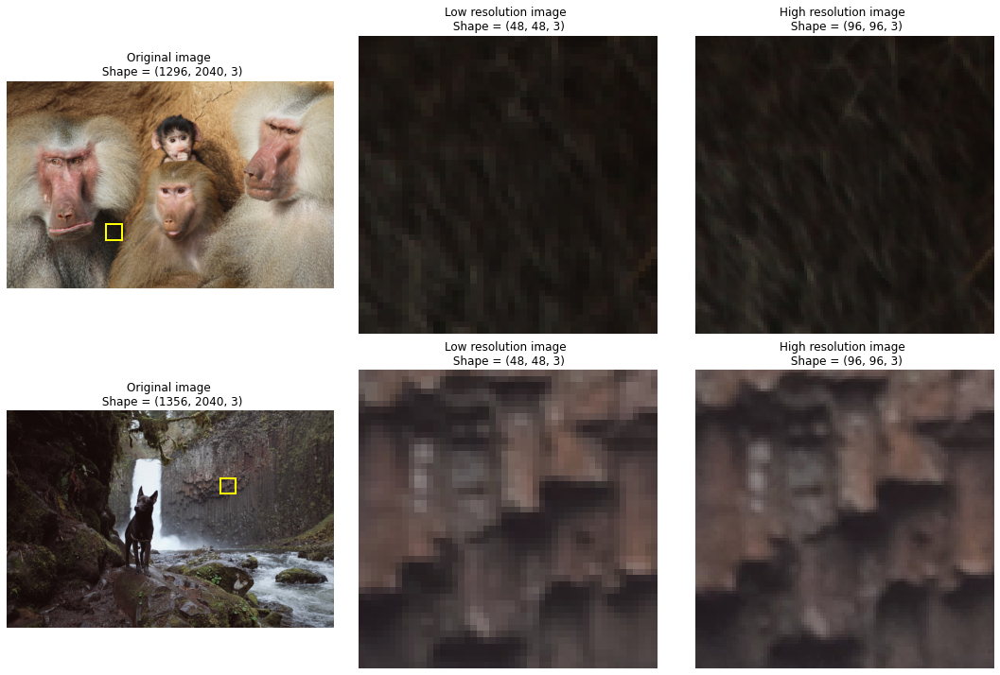

In [3]:
print_images(dataset=train_bicubic_x2, num_images=2, patch_size=PATCH_SIZE)

# The model(s)

## Initialization

We can either train an instance of our edsr model from scratch or load pretrained weights.<br>
The "scale" parameter determines the upscaling factor of the model.

In this version we first trained the x2 scale model for 200 epochs.<br>
For the x3 and 4x we then loaded the x2 weights and trained them for additional 200 epochs on their respective datasets each.

In [4]:
# # initialize a new instance of the EDSR model
# edsrX2 = EDSR(numResBlocks=16,scale=2,patch_size=PATCH_SIZE)

In [5]:
# # initialize model with pretrained weights

# edsrX2 = EDSR(numResBlocks=16,scale=2,patch_size=PATCH_SIZE)
# edsrX2.build((1,PATCH_SIZE,PATCH_SIZE,3))
# edsrX2.load_weights('weights/weights_x2_200')

## Training

Dataset and model can be changed to train the for the different scales.

In [6]:
# # preprocess the input
# train_dataset, test_dataset = input_pipeline(train=train_bicubic_x2, test=test_bicubic_x2, scale=2)

# # get test images for tensorboard visualization
# test_images, _, _ = dataset_to_array(dataset=test_bicubic_x2)

# # train our EDSR with the given datasets
# train(model=edsrX2, train_dataset=train_dataset, test_dataset=test_dataset, epochs=200, patch_size=PATCH_SIZE, tensorboard_images=test_images)

In [7]:
# # Save the weights after training
# edsr.save_weights('weights/weights_x2', save_format= 'tf')

In [8]:
# Training progress tracking
# We included the logs from our respective trainings of the 3 models for 200 epochs each

# PSNR: Peak signal-to-noice ratio, ratio between noise and information
# SSIM: Structural similarity index measure, measure for quality of compressed or reconstructed images

%load_ext tensorboard
%tensorboard --logdir logs/gradient_tape

Reusing TensorBoard on port 6006 (pid 54242), started 2:37:33 ago. (Use '!kill 54242' to kill it.)

# Results

## The trained models

Since the training took some time we trained the models seperately and only load the weights here to show the results

In [9]:
# The x2 scaling model

edsrX2 = EDSR(numResBlocks=16,scale=2,patch_size=PATCH_SIZE)
edsrX2.build((1,PATCH_SIZE,PATCH_SIZE,3))
edsrX2.load_weights('weights/weights_x2_200')

In [10]:
# The x3 scaling model

edsrX3 = EDSR(numResBlocks=16,scale=3,patch_size=PATCH_SIZE)
edsrX3.build((1,PATCH_SIZE,PATCH_SIZE,3))
edsrX3.load_weights('weights/weights_x3_200')

In [11]:
# The x4 scaling model

edsrX4 = EDSR(numResBlocks=16,scale=4,patch_size=PATCH_SIZE)
edsrX4.build((1,PATCH_SIZE,PATCH_SIZE,3))
edsrX4.load_weights('weights/weights_x4_200')

## Example images

In the following section you can look at several image comparisons between our results and the original images.<br><br>
To look at the results from the different scaling models you can just relace the model and dataset in the respective functions.

### Some example images produced by the EDSR network

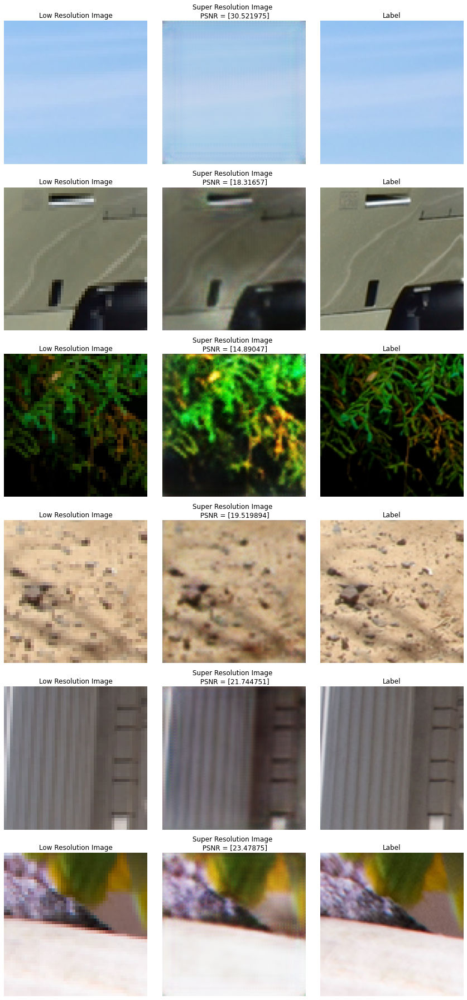

In [12]:
plot_edsr_images(model=edsrX2,dataset=test_bicubic_x2, patch_size=PATCH_SIZE, num_images=6)

### Some example images produced using Geometric Self-ensamble

Here we reconstructed the proposed method described in the paper to enhance the image quality.

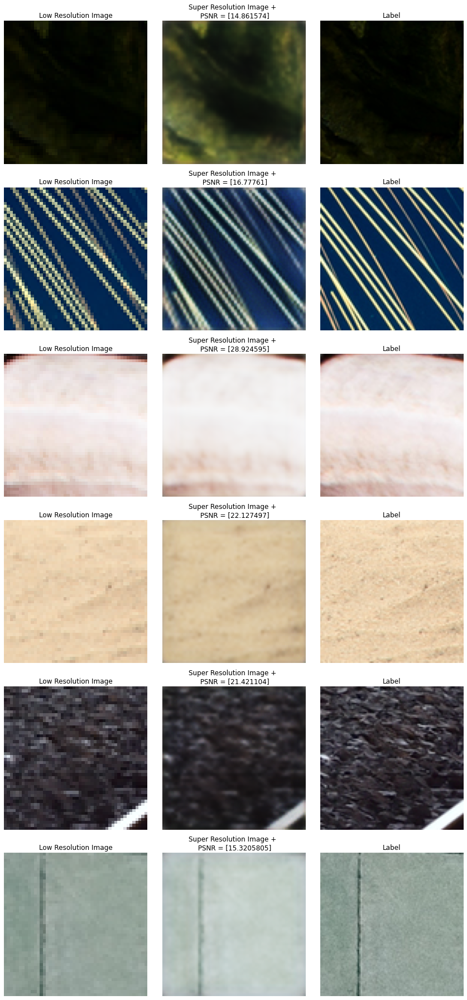

In [13]:
plot_edsr_images(model=edsrX2, dataset=test_bicubic_x2, patch_size=PATCH_SIZE, num_images=6, geom=True)

### Method comparison

In the end you can compare the high resolution label and the downscaled bicubic version with the resulst from our model with and without Geometric Self-ensemble

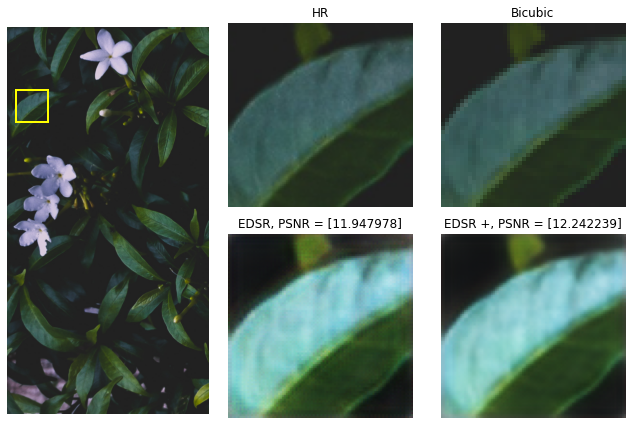

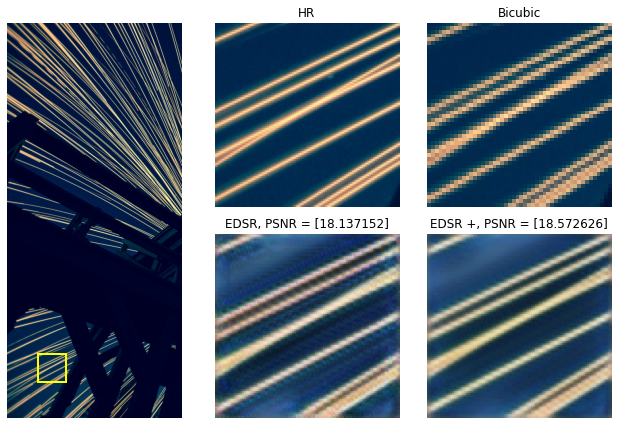

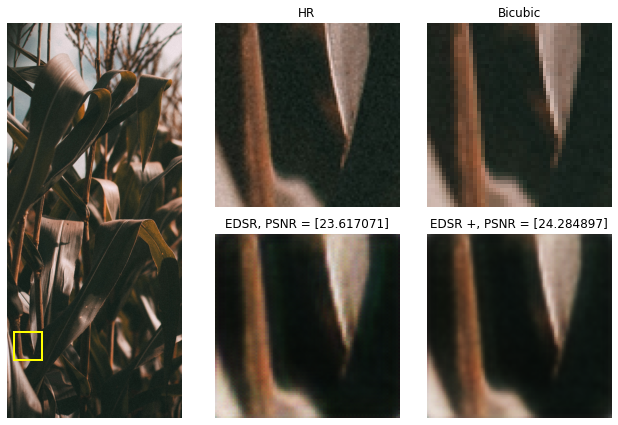

In [14]:
print_pictureComparison(edsrX2,dataset=test_bicubic_x2, num_images=3, patch_size=PATCH_SIZE)